In [1]:
!pip install -U dataprep

In [2]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import matplotlib.pyplot as plt
import seaborn as sns
from dataprep.eda import plot ,plot_diff, plot_missing,plot_correlation,create_report

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

/kaggle/input/seoul-bike-rental-ai-pro-iti/sample_submission.csv
/kaggle/input/seoul-bike-rental-ai-pro-iti/train.csv
/kaggle/input/seoul-bike-rental-ai-pro-iti/test.csv


In [3]:
train_df = pd.read_csv("/kaggle/input/seoul-bike-rental-ai-pro-iti/train.csv")
test_df = pd.read_csv("/kaggle/input/seoul-bike-rental-ai-pro-iti/test.csv")
gs = pd.read_csv("/kaggle/input/seoul-bike-rental-ai-pro-iti/sample_submission.csv")

### SIMPLE EDA

In [4]:
train_df.head()

,ID,Date,y,Hour,Temperature(�C),Humidity(%),Wind speed (m/s),Visibility (10m),Dew point temperature(�C),Solar Radiation (MJ/m2),Rainfall(mm),Snowfall (cm),Seasons,Holiday,Functioning Day
0,0,01/12/2017,254,0,-5.2,37,2.2,2000,-17.6,0.0,0.0,0.0,Winter,No Holiday,Yes
1,1,01/12/2017,204,1,-5.5,38,0.8,2000,-17.6,0.0,0.0,0.0,Winter,No Holiday,Yes
2,2,01/12/2017,173,2,-6.0,39,1.0,2000,-17.7,0.0,0.0,0.0,Winter,No Holiday,Yes
3,3,01/12/2017,107,3,-6.2,40,0.9,2000,-17.6,0.0,0.0,0.0,Winter,No Holiday,Yes
4,4,01/12/2017,78,4,-6.0,36,2.3,2000,-18.6,0.0,0.0,0.0,Winter,No Holiday,Yes


In [5]:
test_df.head()

,ID,Date,Hour,Temperature(�C),Humidity(%),Wind speed (m/s),Visibility (10m),Dew point temperature(�C),Solar Radiation (MJ/m2),Rainfall(mm),Snowfall (cm),Seasons,Holiday,Functioning Day
0,5760,21/12/2017,0,-1.3,90,2.0,259,-2.7,0.0,0.0,2.2,Winter,No Holiday,Yes
1,5761,21/12/2017,1,-1.8,90,1.6,263,-3.2,0.0,0.0,2.2,Winter,No Holiday,Yes
2,5762,21/12/2017,2,-2.2,88,1.4,348,-3.9,0.0,0.0,2.2,Winter,No Holiday,Yes
3,5763,21/12/2017,3,-2.9,89,1.3,288,-4.4,0.0,0.0,2.2,Winter,No Holiday,Yes
4,5764,21/12/2017,4,-3.6,91,1.2,241,-4.8,0.0,0.0,2.2,Winter,No Holiday,Yes


In [6]:
train_df.describe()

,ID,y,Hour,Temperature(�C),Humidity(%),Wind speed (m/s),Visibility (10m),Dew point temperature(�C),Solar Radiation (MJ/m2),Rainfall(mm),Snowfall (cm)
count,5760.000000,5760.000000,5760.000000,5760.000000,5760.000000,5760.000000,5760.000000,5760.000000,5760.000000,5760.000000,5760.000000
mean,2879.500000,703.483854,11.500000,12.803559,58.361806,1.723333,1473.711458,4.058264,0.572325,0.135122,0.046302
std,1662.913107,655.249491,6.922788,11.902206,19.840167,1.047898,585.879880,13.003582,0.869943,1.075320,0.323728
min,0.000000,0.000000,0.000000,-15.100000,0.000000,0.000000,27.000000,-26.900000,0.000000,0.000000,0.000000
25%,1439.750000,188.000000,5.750000,3.200000,43.000000,0.900000,1025.750000,-5.400000,0.000000,0.000000,0.000000
50%,2879.500000,485.500000,11.500000,13.700000,57.000000,1.500000,1732.000000,5.200000,0.010000,0.000000,0.000000
75%,4319.250000,1066.000000,17.250000,22.225000,73.000000,2.300000,2000.000000,14.700000,0.940000,0.000000,0.000000
max,5759.000000,3556.000000,23.000000,39.400000,98.000000,7.400000,2000.000000,27.200000,3.520000,35.000000,5.100000


In [7]:
train_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5760 entries, 0 to 5759
Data columns (total 15 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   ID                         5760 non-null   int64  
 1   Date                       5760 non-null   object 
 2   y                          5760 non-null   int64  
 3   Hour                       5760 non-null   int64  
 4   Temperature(�C)            5760 non-null   float64
 5   Humidity(%)                5760 non-null   int64  
 6   Wind speed (m/s)           5760 non-null   float64
 7   Visibility (10m)           5760 non-null   int64  
 8   Dew point temperature(�C)  5760 non-null   float64
 9   Solar Radiation (MJ/m2)    5760 non-null   float64
 10  Rainfall(mm)               5760 non-null   float64
 11  Snowfall (cm)              5760 non-null   float64
 12  Seasons                    5760 non-null   object 
 13  Holiday                    5760 non-null   objec

In [8]:
test_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3000 entries, 0 to 2999
Data columns (total 14 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   ID                         3000 non-null   int64  
 1   Date                       3000 non-null   object 
 2   Hour                       3000 non-null   int64  
 3   Temperature(�C)            3000 non-null   float64
 4   Humidity(%)                3000 non-null   int64  
 5   Wind speed (m/s)           3000 non-null   float64
 6   Visibility (10m)           3000 non-null   int64  
 7   Dew point temperature(�C)  3000 non-null   float64
 8   Solar Radiation (MJ/m2)    3000 non-null   float64
 9   Rainfall(mm)               3000 non-null   float64
 10  Snowfall (cm)              3000 non-null   float64
 11  Seasons                    3000 non-null   object 
 12  Holiday                    3000 non-null   object 
 13  Functioning Day            3000 non-null   objec

  0%|          | 0/872 [00:00<?, ?it/s]


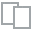
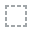
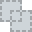
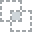
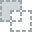
...
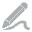
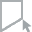
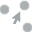
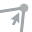
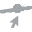

In [9]:
plot(train_df)


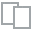
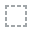
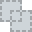
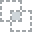
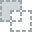
...
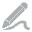
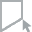
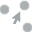
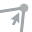
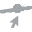

In [10]:
plot_correlation(train_df)

  0%|          | 0/175 [00:00<?, ?it/s]


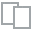
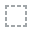
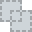
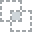
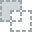
...
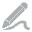
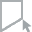
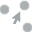
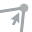
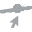

In [11]:
plot_missing(train_df)

  0%|          | 0/167 [00:00<?, ?it/s]


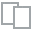
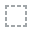
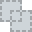
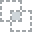
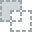
...
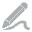
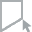
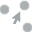
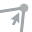
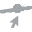

In [12]:
plot_missing(test_df)

  0%|          | 0/2407 [00:00<?, ?it/s]


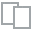
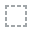
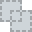
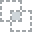
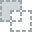
...
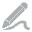
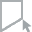
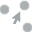
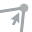
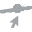

Report has been saved to /kaggle/working/train_data_report.html!


In [13]:
train_data_report = create_report(train_df)

train_data_report.show()

train_data_report.save(filename='train_data_report')

  0%|          | 0/2206 [00:00<?, ?it/s]


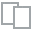
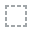
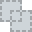
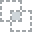
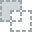
...
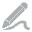
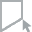
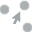
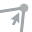
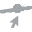

Report has been saved to /kaggle/working/test_data_report.html!


In [14]:
test_data_report = create_report(test_df)

test_data_report.show()

test_data_report.save(filename='test_data_report')

In [15]:
categorical_cols = [cname for cname in train_df.columns if
                    train_df[cname].dtype == "object"]
numerical_cols = [cname for cname in train_df.columns if 
                train_df[cname].dtype in ['int64', 'float64']]

categorical_cols

['Date', 'Seasons', 'Holiday', 'Functioning Day']

In [16]:
numerical_cols

['ID',
 'y',
 'Hour',
 'Temperature(�C)',
 'Humidity(%)',
 'Wind speed (m/s)',
 'Visibility (10m)',
 'Dew point temperature(�C)',
 'Solar Radiation (MJ/m2)',
 'Rainfall(mm)',
 'Snowfall (cm)']

In [17]:
train_df.isnull().sum()

ID                           0
Date                         0
y                            0
Hour                         0
Temperature(�C)              0
Humidity(%)                  0
Wind speed (m/s)             0
Visibility (10m)             0
Dew point temperature(�C)    0
Solar Radiation (MJ/m2)      0
Rainfall(mm)                 0
Snowfall (cm)                0
Seasons                      0
Holiday                      0
Functioning Day              0
dtype: int64

In [18]:
test_df.isnull().sum()

ID                           0
Date                         0
Hour                         0
Temperature(�C)              0
Humidity(%)                  0
Wind speed (m/s)             0
Visibility (10m)             0
Dew point temperature(�C)    0
Solar Radiation (MJ/m2)      0
Rainfall(mm)                 0
Snowfall (cm)                0
Seasons                      0
Holiday                      0
Functioning Day              0
dtype: int64


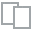
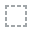
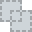
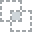
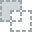
...
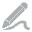
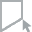
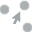
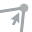
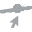

In [19]:
pom = train_df.drop("y",axis=1,inplace=False)
plot_diff([pom,test_df])

******MODELING

In [20]:
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import OneHotEncoder
from sklearn.metrics import accuracy_score
from sklearn.model_selection import train_test_split

In [21]:
categorical_cols = [cname for cname in train_df.columns if
                    train_df[cname].dtype == "object"]
numerical_cols = [cname for cname in train_df.columns if 
                train_df[cname].dtype in ['int64', 'float64']]

In [22]:
numerical_cols

['ID',
 'y',
 'Hour',
 'Temperature(�C)',
 'Humidity(%)',
 'Wind speed (m/s)',
 'Visibility (10m)',
 'Dew point temperature(�C)',
 'Solar Radiation (MJ/m2)',
 'Rainfall(mm)',
 'Snowfall (cm)']

In [23]:
categorical_cols

['Date', 'Seasons', 'Holiday', 'Functioning Day']

In [24]:
numerical_transformer = SimpleImputer(strategy="constant")


categorical_transformer = Pipeline(steps=[
                                        ("imputer",SimpleImputer(strategy="constant")),
                                        ("onehot",OneHotEncoder(handle_unknown="ignore"))])


preprocessor = ColumnTransformer(
    transformers=[
        ('num', numerical_transformer, numerical_cols),
        ('cat', categorical_transformer, categorical_cols)
    ])

In [25]:
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from xgboost import XGBClassifier

In [26]:
classes = train_df.y


In [27]:
X_train, X_valid, y_train, y_valid = train_test_split(train_df, classes ,
                                                                train_size=0.8, test_size=0.2,
                                                                random_state=123)

In [28]:
lr_model = LogisticRegression(max_iter=1000,random_state=123,C=0.175)
rf_model = RandomForestClassifier(n_estimators=1000,random_state=123)
xgb_model = XGBClassifier(n_estimators=1000,random_state=123,learning_rate=0.01)

In [29]:
lr_pipe = Pipeline(steps=[('preprocessor', preprocessor),
                      ('model', lr_model)
                     ])
rf_pipe = Pipeline(steps=[('preprocessor', preprocessor),
                      ('model', rf_model)
                     ])
xgb_pipe = Pipeline(steps=[('preprocessor', preprocessor),
                      ('model', xgb_model)
                     ])

In [ ]:
lr_pipe.fit(X_train,y_train)
rf_pipe.fit(X_train,y_train)
xgb_pipe.fit(X_train,y_train)

In [ ]:
lr_pred = lr_pipe.predict(X_valid)
rf_pred = rf_pipe.predict(X_valid)
xgb_pred = xgb_pipe.predict(X_valid)

In [ ]:
final_predictions = lr_pipe.predict(test_df)

In [ ]:
submission = pd.DataFrame({'Id':test_ids,'y':final_predictions})
submission.to_csv('submission.csv',index = False)